In [1]:
from time import time
import json
import pandas as pd 
from src_yolov8_tracking       import inference as inf
from src_tracking_embedding    import inference as emb
from src_tracking_face_quality import inference as fq
from src_tracking_split        import inference as st
from src_tracking_merge        import NEW_inference_V2 as mrg
from utils_split_merge.utils   import find_threshold

import pandas as pd
from shot_detection.src.model import TransNetV2
import os
import tqdm

import tensorflow as tf
from tensorflow.keras import backend as K
import torch

import json
import numpy as np

class NumpyEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        if isinstance(obj, (np.float32, np.float64)):
            return float(obj)
        if isinstance(obj, (np.int32, np.int64)):
            return int(obj)
        return super(NumpyEncoder, self).default(obj)

def save_json(path, name, processed_input_data):
    # Construct the full file path
    full_path = f"{path}/{name}.json"
    
    # Save JSON data to the specified file
    with open(full_path, "w") as json_file:
        json.dump(processed_input_data, json_file, cls=NumpyEncoder, indent=4)

    print(f"Data saved to {full_path}")



def clear_gpu():
    # Clear any unused cache memory
    torch.cuda.empty_cache()

    # You can also call garbage collection if needed
    import gc
    gc.collect()

    # Clear cache again for thorough cleanup
    torch.cuda.empty_cache()

    # Clear TensorFlow session, which frees up GPU memory
    K.clear_session()


def update_movie_tracker_output(movie_tracker_output, shot_preds):
    """
    Updates the 'track_id' in movie_tracker_output based on the intervals in shot_preds.

    Args:
        movie_tracker_output (list of dict): List containing rows with 'n' and 'track_id'.
        shot_preds (list of tuples): List of intervals (low, high) to determine the track_id updates.

    Returns:
        list of dict: Updated movie tracker output with modified 'track_id's.
    """
    output = []

    for row in movie_tracker_output:
        out_row = row.copy()
        n = row["n"]
        track_id = row["track_id"]
        
        for i, interval in enumerate(shot_preds):
            low, high = interval
            if low <= n <= high:
                out_row["track_id"] = 1000 * i + track_id
        
        output.append(out_row)

    return output

class NumpyEncoder(json.JSONEncoder):
      def default(self, obj):
          if isinstance(obj, np.ndarray):
             return obj.tolist()
          if isinstance(obj, (np.float32, np.float64)):
             return float(obj)
          if isinstance(obj, (np.int32, np.int64)):
             return int(obj)
          return super(NumpyEncoder, self).default(obj)
          
def NEW_pipeline_wo_out_fn_FINAL_v2(model_dir,
                                    payload, 
                                    constant_height_theshold = 55,
                                    constant_width_theshold = 55,
                                    constant_face_quality_theshold = 0.2,                   
                                    model_name= "Facenet512", # "InsightFace"
                                    isOutputDataFrame = True):
    # Yolov8 tracking start
    computational_times = {}
    content_type = 'text/csv'
    
    clear_gpu()
    model = inf.model_fn(model_dir)
    input_data = inf.input_fn(payload, content_type)
    
    first_start = time()
    prediction_output = inf.predict_fn(input_data, model)
    #  prediction_output = {"movie_tracker_output": movie_tracker_output, "nufs": nufs, "status": status} 
    
    end = time()
    computational_times["Yolov8_tracking"] = end - first_start
    print("len(prediction_output['movie_tracker_output']): ", len(prediction_output["movie_tracker_output"]))
    # Yolov8 tracking end
    clear_gpu()
    ###########################################################################################################
    s3_bucket, s3_key, video_name, local_dir = payload.split("|")

    #video = '../ankit_movi/AE16546-2022-17-202738.mp4'
    video = f"{local_dir}/{video_name}"
    print("!!!!!!!! video: ", video)      
    
    clear_gpu()
    shot_detection_model_dir = 'shot_detection/models/transnetv2-weights'
    shot_detection_model = TransNetV2(model_dir=shot_detection_model_dir)
    print("Shot Detection Start")
    video_frames, single_frame_predictions, all_frame_predictions = shot_detection_model.predict_video(video)
    
    shot_preds = shot_detection_model.predictions_to_scenes(single_frame_predictions)  
    print("Shot prediction:")
    print(shot_preds)
    print("Shot Detection End")
    movie_tracker_output = prediction_output["movie_tracker_output"].copy()
    output = update_movie_tracker_output(movie_tracker_output, shot_preds)
    prediction_output["movie_tracker_output"] = output
    print("Shot Detection and Update End")
    ###########################################################################################################
    # EMBEDDING
    # face embedding start
    model = emb.model_fn(model_dir)
    start = time()
    prediction_output = emb.predict_fn(prediction_output, model, embedding_type = model_name)
    # prediction_output = {"movie_tracker_output": output, "nufs": nufs}
    
    end = time()
    computational_times["face_embedding"] = end - start
    # face embedding end 

    # face quality start
    clear_gpu()
    ###########################################################################################################   
    # QUALITY
    model = fq.model_fn(model_dir)
    start = time()
    prediction_output = fq.predict_fn(prediction_output, model)
    prediction_output = fq.NEW_output_fn(prediction_output)
    print("check Ali qualities were added: ", prediction_output["movie_tracker_output"][0].keys())
    
    # prediction_output = {"movie_tracker_output": movie_tracker_output, "quality_scores": quality_scores, "nufs": nufs}
    end = time()
    computational_times["face_quality"] = end - start
    # face quality end
    ########################################################################################################### 
    # SPLIT
    # track split start
    model = st.model_fn(model_dir)
    
    start = time()
    prediction_output["movie_name"] = video_name
    prediction_output["constant_height_theshold"] = constant_height_theshold
    prediction_output["constant_width_theshold"] = constant_width_theshold
    prediction_output["constant_face_quality_theshold"] = constant_face_quality_theshold
    prediction_output["similarity_threshold"] = find_threshold(model_name = model_name, distance_metric = "cosine")   
    
    split_map_track_ids = st.predict_fn(prediction_output, model)
    end = time()
    computational_times["track_splitting"] = end - start
    print("split_map_track_ids: ", split_map_track_ids)
    # track split end

    # update track_id after splitting start
    fq_out = prediction_output.copy()
    print("after SPLIT, fq_out.keys(): ", fq_out.keys())
    del prediction_output
    quality_movie_tracker_output = fq_out["movie_tracker_output"].copy()
    
    split_map_track_ids = {elem: int(split_map_track_ids[elem]) for elem in split_map_track_ids}
    split_movie_tracker_output = []
    for elem in quality_movie_tracker_output:
        n        = int(elem["n"])
        track_id = int(elem["track_id"])
        elem["origin_track_id"] = track_id
        # "track_id is SPLIT track_id HERE
        elem["track_id"] = split_map_track_ids.get(str(n) + "_" + str(track_id), track_id)
        split_movie_tracker_output.append(elem)    
    fq_out['movie_tracker_output'] = split_movie_tracker_output
    del split_movie_tracker_output
    # update track_id after splitting end
    ########################################################################################################### 
    # MERGE
    # Merge tracks start
    print("!!! MERGE!!!")
    
    #merge_path = f"merge_predict_fn/FINAL_V2/fq_out/{video_name}"
    #os.makedirs(merge_path, exist_ok=True)
    #save_json(merge_path, "after_split_data.json", fq_out)
    
    model = mrg.model_fn(model_dir)
    start = time()
    print("before MERGE, fq_out.keys(): ", fq_out.keys())
    merged_map_track_ids = mrg.NEW_predict_fn(fq_out, model, useBadFace = False,  embedding_type = model_name)
    end = time()
    computational_times["track_merging"] = end - start
    merged_map_track_ids = {int(key): int(merged_map_track_ids[key]) for key in merged_map_track_ids}
    print("merged_map_track_ids: ", merged_map_track_ids)
    # Merge tracks end

    quality_movie_tracker_output = fq_out["movie_tracker_output"].copy()
    del fq_out

    final_movie_tracker_output = []
    for elem in quality_movie_tracker_output:
        n        = int(elem["n"])
        track_id = int(elem["origin_track_id"])
        elem["split_track_id"] = split_map_track_ids.get(str(n) + "_" + str(track_id), track_id)
        elem["merge_track_id"] = merged_map_track_ids.get(elem["split_track_id"], int(elem["split_track_id"])) 

        if "face" in elem:
           del elem["face"]

        if "embedding" in elem:
           del elem["embedding"]
            
        final_movie_tracker_output.append(elem)

    del quality_movie_tracker_output   
    
    if isOutputDataFrame:
       cols = ["n", 
               "height", 
               "width", 
               "channels", 
               "bounding_box", 
               "confidence", 
               "face_quality",
               "sharp_score", 
               "blur_score",
               "track_id", 
               "split_track_id", 
               "merge_track_id"] 
       final_movie_tracker_output = pd.DataFrame(final_movie_tracker_output)[cols].copy()
    end_last = time()
    computational_times["total"] = end_last - first_start
    return final_movie_tracker_output, computational_times

print("OK")

E0000 00:00:1758565533.831229    4342 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1758565533.875143    4342 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


OK


In [2]:
print("Start Computation")
model_dir = ""
s3_bucket = 'LOCAL'
s3_key = ''
video_name = 'alex_pilot.mp4'

local_dir = 'alex_movies'
payload_tuple = (s3_bucket, s3_key, video_name, local_dir)
payload = "|".join(payload_tuple)
from time import time
start = time()
#results, computational_times = NEW_pipeline_wo_out_fn(model_dir, payload, isOutputDataFrame = True)
results, computational_times = NEW_pipeline_wo_out_fn_FINAL_v2(model_dir, payload, isOutputDataFrame = True)

end = time()
print("computational time by stage:")
print(computational_times)
print("computational time: ", end - start, ", average per face: ", (end - start) / len(results), ", len(results): ", len(results))
print("Number of Faces using tracking only: ", results["track_id"     ].nunique())
print("Number of Faces after splitting:     ", results["split_track_id"].nunique())
print("Number of Faces after merging:       ", results["merge_track_id"].nunique())

Start Computation
Executing model_fn from inference.py ...
status:  !!! The directory alex_movies) does exist: True| The file alex_movies/alex_pilot.mp4 does exist: True
number of frames:  311.0
movie fps:  30.0
duration in seconds: 10
video time: 0:00:10
Tracking frame 0


/home/alexdolia/miniconda3/envs/tf/lib/python3.9/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


Tracking frame 100
Tracking frame 200
Tracking frame 300
Number of Frames:  311
!!!!!!!!! Number of track ids after tracking:  22
len(prediction_output['movie_tracker_output']):  203
!!!!!!!! video:  alex_movies/alex_pilot.mp4


W0000 00:00:1758565559.683026    4342 gpu_device.cc:2344] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Shot Detection Start
[TransNetV2] Processing video frames 311/311
Shot prediction:
[[  0 206]
 [208 310]]
Shot Detection End
Shot Detection and Update End
Executing model_fn from inference.py ... /home/alexdolia/Alex/XR/FINAL_V2_code


Processing images: 100%|█████████████████████████████████████████████████████████████| 203/203 [01:26<00:00,  2.35img/s]


Executing model_fn from inference.py ...


 Inference : 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.79it/s]


check Ali qualities were added:  dict_keys(['n', 'face', 'height', 'width', 'channels', 'track_id', 'bounding_box', 'confidence', 'embedding', 'face_quality', 'sharp_score', 'blur_score'])
split_map_track_ids:  {'190_25': 39}
after SPLIT, fq_out.keys():  dict_keys(['movie_tracker_output', 'nufs', 'movie_name', 'constant_height_theshold', 'constant_width_theshold', 'constant_face_quality_theshold', 'similarity_threshold'])
!!! MERGE!!!
before MERGE, fq_out.keys():  dict_keys(['movie_tracker_output', 'nufs', 'movie_name', 'constant_height_theshold', 'constant_width_theshold', 'constant_face_quality_theshold', 'similarity_threshold'])
MERGE NEW_print_fn, len(input_data):  7
movie_name:  alex_pilot.mp4
similarity_threshold:  0.3
height_theshold:  55
width_theshold:  55
face_quality_theshold:  0.2
good_faces_selection_criterion:  inverse_cosine
bad_faces_selection_criterion:  inverse_cosine
quality_movie_tracker_output[0].keys():
dict_keys(['n', 'face', 'height', 'width', 'channels', 'track

,n,height,width,track_id,confidence,face_quality,sharp_score,blur_score
0,0,219,176,1,0.553037,0.347023,31.263573,1224.673003
1,1,220,176,1,0.556682,0.339157,31.225871,1232.885242
2,2,219,176,1,0.558375,0.345270,31.363950,1225.160268
3,3,219,176,1,0.556808,0.345270,31.363950,1225.160268
4,4,221,177,1,0.522195,0.318345,30.623384,1298.600589


!!!AFTER rename in NEW_utils:  Index(['first', 'second', 'first_n', 'first_track_id', 'second_n',
       'second_track_id', 'inverse_cosine', 'n', 'first_height', 'first_width',
       'track_id', 'first_confidence', 'first_face_quality',
       'first_sharp_score', 'first_blur_score'],
      dtype='object')
!!! cols:  ['first_n', 'first_track_id', 'first_height', 'first_width', 'first_confidence', 'first_face_quality', 'first_sharp_score', 'first_blur_score', 'second_n', 'second_track_id', 'inverse_cosine']
  first second  first_n  first_track_id  second_n  second_track_id  \
0   0_1    1_1        0               1         1                1   
1   0_1    2_1        0               1         2                1   
2   0_1    3_1        0               1         3                1   
3   0_1    4_1        0               1         4                1   
4   0_1    5_1        0               1         5                1   

   inverse_cosine  n  first_height  first_width  track_id  first_

/home/alexdolia/Alex/XR/FINAL_V2_code/src_tracking_merge/NEW_inference_V2.py:196: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  good_inv_cos_df = good_inv_cos_df[(inv_cos_df["worst_width" ] >= width_theshold)].copy()


,first_n,second_n,first_track_id,second_track_id,worst_height,worst_width,worst_face_quality,worst_sharp_score,worst_blur_score,inverse_cosine
2926,0,45,1,20,213.0,164.0,0.245623,31.263573,1143.142967,0.314157
2927,1,45,1,20,213.0,164.0,0.245623,31.225871,1143.142967,0.312214
2928,2,45,1,20,213.0,164.0,0.245623,31.363950,1143.142967,0.314330
2929,3,45,1,20,213.0,164.0,0.245623,31.363950,1143.142967,0.314330
2930,4,45,1,20,213.0,164.0,0.245623,30.623384,1143.142967,0.289175


selected_inv_cos_df:
     first second  inverse_cosine
3656     1     20        0.223867
4364    20     25        0.157577
5367     1     25        0.096733
!!! clusters:  [[1, 20, 25]]
merged_map_track_ids:  {1: 1, 20: 1, 25: 1}
computational time by stage:
{'Yolov8_tracking': 17.381164073944092, 'face_embedding': 86.44396233558655, 'face_quality': 1.11029052734375, 'track_splitting': 0.19150710105895996, 'track_merging': 1.2249705791473389, 'total': 119.15538430213928}
computational time:  119.87754702568054 , average per face:  0.5905297883038451 , len(results):  203
Number of Faces using tracking only:  23
Number of Faces after splitting:      23
Number of Faces after merging:        21


In [3]:
computational_times

{'Yolov8_tracking': 17.381164073944092,
 'face_embedding': 86.44396233558655,
 'face_quality': 1.11029052734375,
 'track_splitting': 0.19150710105895996,
 'track_merging': 1.2249705791473389,
 'total': 119.15538430213928}

In [4]:
results["track_id"].nunique()

23

In [5]:
483.47933-307.10302734375,

(176.37630265625,)

In [6]:
results

,n,height,width,channels,bounding_box,confidence,face_quality,sharp_score,blur_score,track_id,split_track_id,merge_track_id
0,0,219,176,3,"[307.10302734375, 266.5565185546875, 483.47933...",0.553037,0.347023,31.263573,1224.673003,1,1,1
1,1,220,176,3,"[307.1987609863281, 266.6537170410156, 483.454...",0.556682,0.339157,31.225871,1232.885242,1,1,1
2,2,219,176,3,"[307.2633056640625, 266.670654296875, 483.4568...",0.558375,0.345270,31.363950,1225.160268,1,1,1
3,3,219,176,3,"[307.2745361328125, 266.66082763671875, 483.46...",0.556808,0.345270,31.363950,1225.160268,1,1,1
4,4,221,177,3,"[304.8353576660156, 266.37847900390625, 481.64...",0.522195,0.318345,30.623384,1298.600589,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
198,186,201,160,3,"[412.948974609375, 324.45758056640625, 572.158...",0.605387,0.035737,10.229182,669.323419,25,25,1
199,187,205,162,3,"[409.9386291503906, 322.5419921875, 571.070068...",0.570214,0.085845,5.957502,549.174455,25,25,1
200,188,209,162,3,"[409.4097900390625, 318.9649658203125, 571.225...",0.569290,0.159379,5.613698,479.992480,25,25,1
201,189,210,162,3,"[409.322509765625, 317.4540710449219, 571.3928...",0.568709,0.154821,5.594598,479.728520,25,25,1


In [21]:
import cv2
import pandas as pd
import matplotlib.pyplot as plt

def annotate_video_frames(video_path, df, frame_ids = [0]):
    """
    Annotate video frames based on dataframe info.
    
    Parameters:
    -----------
    video_path : str
        Path to the mp4 file.
    df : pd.DataFrame
        DataFrame with columns: 
        ['n', 'height', 'width', 'bounding_box', 'confidence', 
         'face_quality', 'sharp_score', 'blur_score', 
         'track_id', 'split_track_id', 'merge_track_id']
    """
    if frame_ids is not None:
       df = df.loc[df["n"].isin(frame_ids)].drop_duplicates(subset = ["n"]).copy()
    
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return
    
    frame_indices = df['n'].unique()  # only frames we need
    frame_indices_set = set(frame_indices)

    frame_num = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        
        if frame_num in frame_indices_set:
            frame_rows = df[df['n'] == frame_num]
            
            # Convert to RGB for plotting
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            
            plt.figure(figsize=(10, 6))
            plt.imshow(frame_rgb)
            
            for _, row in frame_rows.iterrows():
                x1, y1, x2, y2 = row['bounding_box']  # XYXY format
                
                # Draw bounding box
                plt.gca().add_patch(plt.Rectangle(
                    (x1, y1), x2 - x1, y2 - y1, 
                    linewidth=2, edgecolor='red', facecolor='none'
                ))
                
                # Build annotation text
                text_lines = [
                    f"Confidence: {row['confidence']:.2f}",
                    f"Face Quality: {row['face_quality']:.2f}",
                    f"Sharp Score: {row['sharp_score']:.2f}",
                    f"Blur Score: {row['blur_score']:.2f}",
                    f"Track ID: {row['track_id']}",
                    f"Split Track ID: {row['split_track_id']}",
                    f"Merge Track ID: {row['merge_track_id']}"
                ]
                
                # Top-right corner of the bounding box
                text_x = x2 + 5
                text_y = y1 + 15  # start slightly below top of box
                
                line_spacing = 55  # <-- increased spacing between lines
                
                for i, line in enumerate(text_lines):
                    plt.text(
                        text_x, text_y + i * line_spacing, line, 
                        fontsize=9, color='yellow', 
                        bbox=dict(facecolor='black', alpha=0.5, pad=2)
                    )
            
            plt.title(f"Frame {frame_num}")
            plt.axis('off')
            plt.show()
            
        frame_num += 1

    cap.release()


In [8]:
results

,n,height,width,channels,bounding_box,confidence,face_quality,sharp_score,blur_score,track_id,split_track_id,merge_track_id
0,0,219,176,3,"[307.10302734375, 266.5565185546875, 483.47933...",0.553037,0.347023,31.263573,1224.673003,1,1,1
1,1,220,176,3,"[307.1987609863281, 266.6537170410156, 483.454...",0.556682,0.339157,31.225871,1232.885242,1,1,1
2,2,219,176,3,"[307.2633056640625, 266.670654296875, 483.4568...",0.558375,0.345270,31.363950,1225.160268,1,1,1
3,3,219,176,3,"[307.2745361328125, 266.66082763671875, 483.46...",0.556808,0.345270,31.363950,1225.160268,1,1,1
4,4,221,177,3,"[304.8353576660156, 266.37847900390625, 481.64...",0.522195,0.318345,30.623384,1298.600589,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
198,186,201,160,3,"[412.948974609375, 324.45758056640625, 572.158...",0.605387,0.035737,10.229182,669.323419,25,25,1
199,187,205,162,3,"[409.9386291503906, 322.5419921875, 571.070068...",0.570214,0.085845,5.957502,549.174455,25,25,1
200,188,209,162,3,"[409.4097900390625, 318.9649658203125, 571.225...",0.569290,0.159379,5.613698,479.992480,25,25,1
201,189,210,162,3,"[409.322509765625, 317.4540710449219, 571.3928...",0.568709,0.154821,5.594598,479.728520,25,25,1


The NUMBER OF UNIQUE PEOPLE:  1


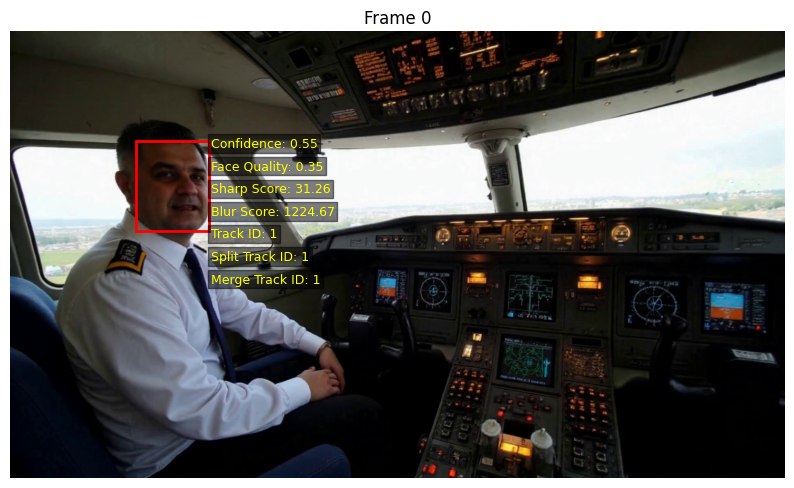

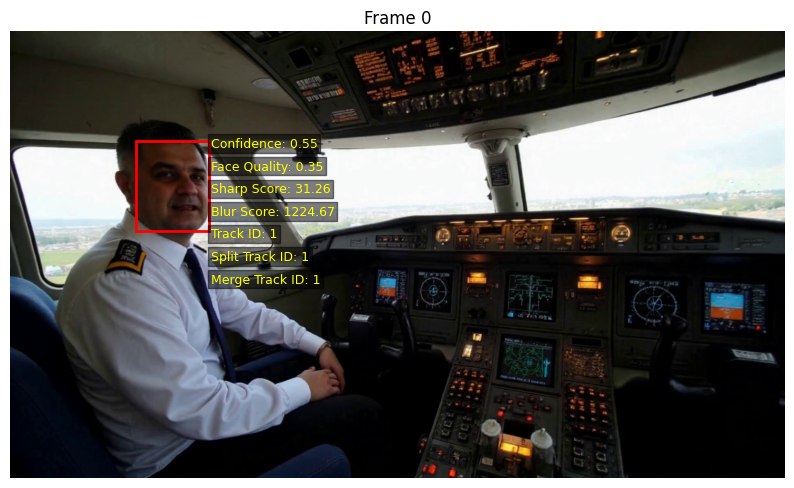

In [22]:
# Set the initial video path (used later for annotation)
video_path = 'alex_movies/alex_pilot.mp4'

# Make a copy of the original results DataFrame to avoid modifying it directly
df = results.copy()

# --- Constants for filtering thresholds ---
MIN_HEIGHT = 50         # Minimum height (pixels) of detected face regions
MIN_WIDTH = 50          # Minimum width (pixels) of detected face regions
MIN_FACE_QUALITY = 0.2  # Minimum face quality score (0–1 scale)
MAX_SHARP_SCORE = 400   # Maximum sharpness score (lower = sharper image)
MIN_BLUR_SCORE = 1000   # Minimum blur score (higher = less blurry image)

# Define the video path again as a constant for clarity
VIDEO_PATH = 'alex_movies/alex_pilot.mp4'

# --- Filter the DataFrame using the defined thresholds ---
df = results.copy()  # Copy again to ensure a fresh start before filtering
df = df[
    (df["height"] >= MIN_HEIGHT) &            # Keep rows where face height ≥ MIN_HEIGHT
    (df["width"] >= MIN_WIDTH) &              # Keep rows where face width ≥ MIN_WIDTH
    (df["face_quality"] >= MIN_FACE_QUALITY) &# Keep rows where face quality ≥ MIN_FACE_QUALITY
    (df["sharp_score"] <= MAX_SHARP_SCORE) &  # Keep rows where sharpness score ≤ MAX_SHARP_SCORE
    (df["blur_score"] >= MIN_BLUR_SCORE)      # Keep rows where blur score ≥ MIN_BLUR_SCORE
].copy()  # Create a filtered copy of the DataFrame

print("The NUMBER OF UNIQUE PEOPLE: ", df["merge_track_id"].nunique())

# --- Annotate video frames using the filtered DataFrame ---
annotate_video_frames(VIDEO_PATH, df)  # Annotate frames using VIDEO_PATH variable

# Optionally, also annotate using the original video_path variable (redundant but possible)
annotate_video_frames(video_path, df)


In [10]:
import cv2
import pandas as pd
import numpy as np
import imageio
from IPython.display import Video, display
from tqdm.notebook import tqdm  # progress bar

def annotate_video(input_path, df, output_path, fps=30):
    """
    Annotate a video with bounding boxes and face metrics.

    Parameters
    ----------
    input_path : str
        Path to input video.
    df : pandas.DataFrame
        DataFrame with columns:
        ['n','height','width','bounding_box','confidence','face_quality',
         'sharp_score','blur_score','track_id','split_track_id','merge_track_id']
    output_path : str
        Path to save annotated video.
    fps : int
        Frames per second for output video.
    """
    # Open video
    cap = cv2.VideoCapture(input_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Group rows by frame number to handle multiple faces
    frame_dict = df.groupby('n').apply(lambda x: x.to_dict('records')).to_dict()

    # Output writer using imageio
    writer = imageio.get_writer(output_path, fps=fps, codec='libx264', quality=8)

    for i in tqdm(range(frame_count), desc="Annotating Frames"):
        ret, frame = cap.read()
        if not ret:
            break

        if i in frame_dict:
            for info in frame_dict[i]:
                # Convert bounding box safely to int list
                bbox = info['bounding_box']
                if isinstance(bbox, str):
                    # if it's a string like "[x1,y1,x2,y2]" convert to list
                    bbox = eval(bbox)
                bbox = np.array(bbox, dtype=np.int32).flatten()
                if len(bbox) != 4:
                    continue
                x1, y1, x2, y2 = bbox

                # Draw rectangle
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

                # Put text in top-right corner with spacing
                texts = [
                    f"Confidence: {info['confidence']:.2f}",
                    f"Face Quality: {info['face_quality']:.2f}",
                    f"Sharp Score: {info['sharp_score']:.2f}",
                    f"Blur Score: {info['blur_score']:.2f}",
                    f"Track ID: {info['track_id']}",
                    f"Split ID: {info['split_track_id']}",
                    f"Merge ID: {info['merge_track_id']}"
                ]

                text_x = x2 + 5
                text_y = max(y1, 20)
                line_spacing = 25  # more spacing

                for i, line in enumerate(texts):
                    y_pos = text_y + i * line_spacing
                    cv2.putText(
                        frame, line, (text_x, y_pos),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 0), 2, cv2.LINE_AA
                    )
                    
                #for j, txt in enumerate(texts):
                #    y = 30 + j * 30
                #    cv2.putText(frame, txt, (width - 350, y),
                #                cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 0), 2)

        # Convert BGR to RGB for imageio
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        writer.append_data(frame_rgb)

    writer.close()
    cap.release()
    return output_path

# Example usage:
input_video = 'alex_movies/alex_pilot.mp4'  # Path to input video
output_video = "annotated_output.mp4"

# Annotate video
annotate_video(input_video, df, output_video, fps=30)

# Display in Jupyter Notebook
display(Video(output_video, embed=True))


Annotating Frames:   0%|          | 0/311 [00:00<?, ?it/s]

In [11]:
import jupyterlab
print(jupyterlab.__version__)


4.2.5


In [12]:
# List of libraries (duplicates removed)
libraries = [
    "torch", "os", "json", "io", "cv2", "time", "numpy", "ultralytics", "datetime",
    "boto3", "pandas", "utils_split_merge", "scipy", "collections", "itertools",
    "tqdm", "PIL", "yaml", "random", "importlib", "typing", "torchvision", 
    "deepface_ad", "insightface", "tensorflow", "keras", "abc", "tensorflow.keras"
]

import importlib

versions = {}
for lib in libraries:
    try:
        module = importlib.import_module(lib)
        # Some modules have __version__, some have VERSION, some may need special handling
        version = getattr(module, "__version__", None) or getattr(module, "VERSION", None)
        versions[lib] = version if version else "built-in / version not available"
    except ModuleNotFoundError:
        versions[lib] = "not installed"

# Print versions
for lib, ver in versions.items():
    print(f"{lib}: {ver}")

torch: 2.1.2+cu118
os: built-in / version not available
json: 2.0.9
io: built-in / version not available
cv2: 4.9.0
time: built-in / version not available
numpy: 1.26.0
ultralytics: 8.3.194
datetime: built-in / version not available
boto3: 1.35.59
pandas: 1.4.4
utils_split_merge: built-in / version not available
scipy: 1.13.1
collections: built-in / version not available
itertools: built-in / version not available
tqdm: 4.67.0
PIL: 9.5.0
yaml: 6.0.2
random: built-in / version not available
importlib: built-in / version not available
typing: built-in / version not available
torchvision: 0.16.2+cu118
deepface_ad: built-in / version not available
insightface: 0.7.3
tensorflow: 2.18.0
keras: 3.8.0
abc: built-in / version not available
tensorflow.keras: 3.8.0


/home/alexdolia/miniconda3/envs/tf/lib/python3.9/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.8 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [13]:
import sys
print(sys.version)

3.9.20 (main, Oct  3 2024, 07:27:41) 
[GCC 11.2.0]


In [14]:
import platform
print(platform.python_version())

3.9.20
